In [22]:
import matplotlib.pyplot as plt
import anndata
import numpy as np
import os
import torch
import pandas as pd
download_base = '/orangedata/ExternalData/Allen_WMB_2024Mar06'
reference_data = torch.load(os.path.join(download_base,'minimal_spatial_data.pt'))
reference_data = pd.DataFrame(reference_data.numpy(),columns=['ccf_x','ccf_y','ccf_z','cluster_alias'])
reference_data['cluster_alias'] = reference_data['cluster_alias'].astype(int)
pivot_table = pd.read_csv(os.path.join(download_base,'pivot_table.csv'))
pivot_table.index = pivot_table['cluster_alias']
reference_data = reference_data.join(pivot_table,on='cluster_alias',lsuffix='_',rsuffix='')
reference_data


,ccf_x,ccf_y,ccf_z,cluster_alias_,cluster_alias,neurotransmitter,class,subclass,supertype,cluster,neurotransmitter_color,class_color,subclass_color,supertype_color,cluster_color
0,7.495417,2.445872,1.743854,1408,1408,NaN,04 DG-IMN Glut,038 DG-PIR Ex IMN,0141 DG-PIR Ex IMN_2,0515 DG-PIR Ex IMN_2,#666666,#16f2f2,#3D53CC,#CC7A3D,#73FFBF
1,9.227966,6.133693,0.486187,4218,4218,Glut,23 P Glut,235 PG-TRN-LRN Fat2 Glut,0953 PG-TRN-LRN Fat2 Glut_1,4199 PG-TRN-LRN Fat2 Glut_1,#2B93DF,#6b5ca5,#9B7ACC,#990041,#663D63
2,9.344912,6.989939,0.291452,4218,4218,Glut,23 P Glut,235 PG-TRN-LRN Fat2 Glut,0953 PG-TRN-LRN Fat2 Glut_1,4199 PG-TRN-LRN Fat2 Glut_1,#2B93DF,#6b5ca5,#9B7ACC,#990041,#663D63
3,10.977068,4.398568,2.405989,4218,4218,Glut,23 P Glut,235 PG-TRN-LRN Fat2 Glut,0953 PG-TRN-LRN Fat2 Glut_1,4199 PG-TRN-LRN Fat2 Glut_1,#2B93DF,#6b5ca5,#9B7ACC,#990041,#663D63
4,8.997138,6.798329,0.115985,4218,4218,Glut,23 P Glut,235 PG-TRN-LRN Fat2 Glut,0953 PG-TRN-LRN Fat2 Glut_1,4199 PG-TRN-LRN Fat2 Glut_1,#2B93DF,#6b5ca5,#9B7ACC,#990041,#663D63
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8879863,9.681244,4.453979,4.859184,5255,5255,NaN,33 Vascular,333 Endo NN,1193 Endo NN_1,5311 Endo NN_1,#666666,#858881,#994567,#00992A,#CC3D76
8879864,9.676999,4.291647,4.811681,14939,14939,NaN,30 Astro-Epen,319 Astro-TE NN,1163 Astro-TE NN_3,5225 Astro-TE NN_3,#666666,#594a26,#3DCCB1,#a8afa5,#551799
8879865,9.678760,4.363282,4.817130,5261,5261,NaN,33 Vascular,330 VLMC NN,1188 VLMC NN_2,5301 VLMC NN_2,#666666,#858881,#653D66,#4D5CFF,#79CC5C
8879866,9.678641,4.360346,4.810017,5252,5252,NaN,33 Vascular,333 Endo NN,1193 Endo NN_1,5309 Endo NN_1,#666666,#858881,#994567,#00992A,#5C9994


100%|██████████| 25/25 [00:11<00:00,  2.15it/s]


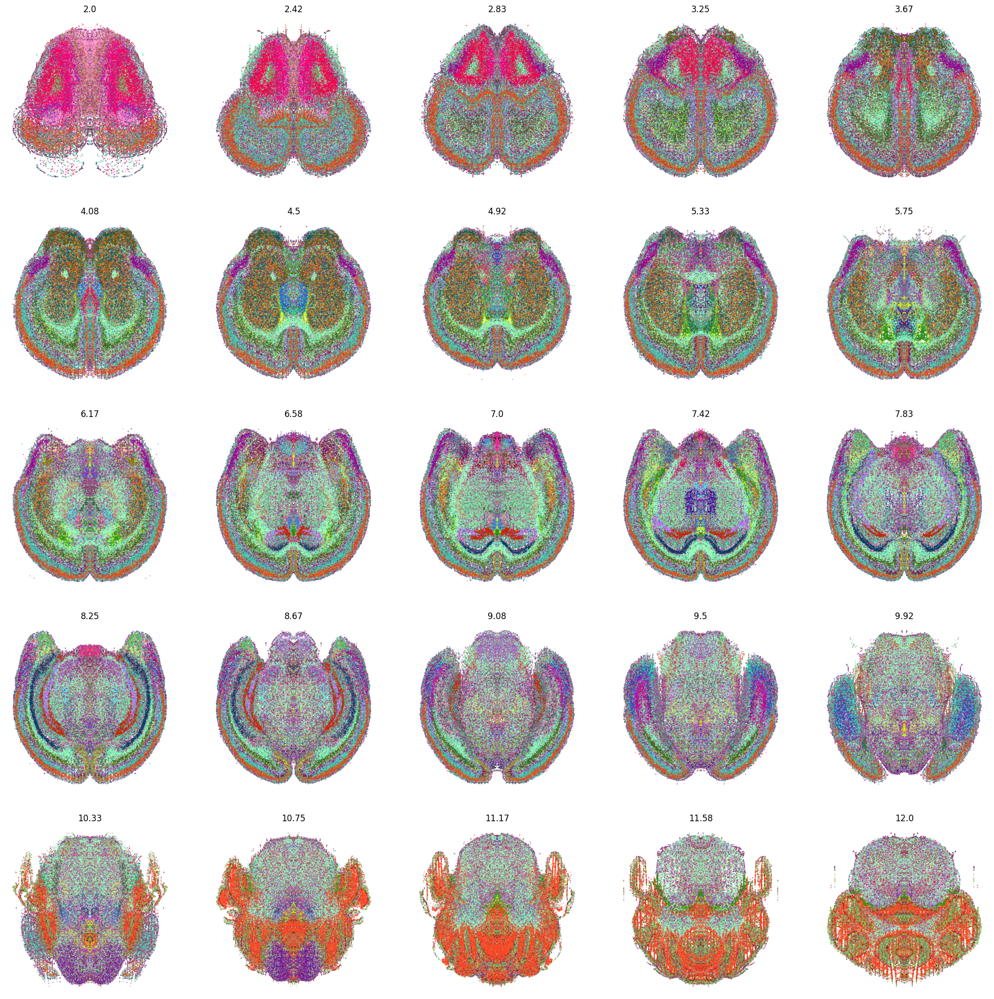

In [25]:
from tqdm import tqdm
n_rows = 5
n_columns = 5
n_figures = n_rows*n_columns
fig,axs = plt.subplots(n_columns,n_rows,figsize=[25,25])
window = 0.15
zs = np.linspace(2,12,n_figures)
axs = axs.ravel()
for i,z in tqdm(enumerate(zs),total=zs.shape[0]):
    m = (reference_data['ccf_x']>z-window)&(reference_data['ccf_x']<z+window)
    m = np.random.choice(np.array(reference_data[m].index),100000)
    x = reference_data.loc[m,'ccf_z']
    y = reference_data.loc[m,'ccf_y']
    c = reference_data.loc[m,'subclass_color']
    axs[i].scatter(x,y,s=0.1,c=c)
    axs[i].scatter(-x,y,s=0.1,c=c)
    axs[i].set_title(str(round(z,2)))
    axs[i].axis('off')
plt.show()

  0%|          | 0/24 [00:00<?, ?it/s]

100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


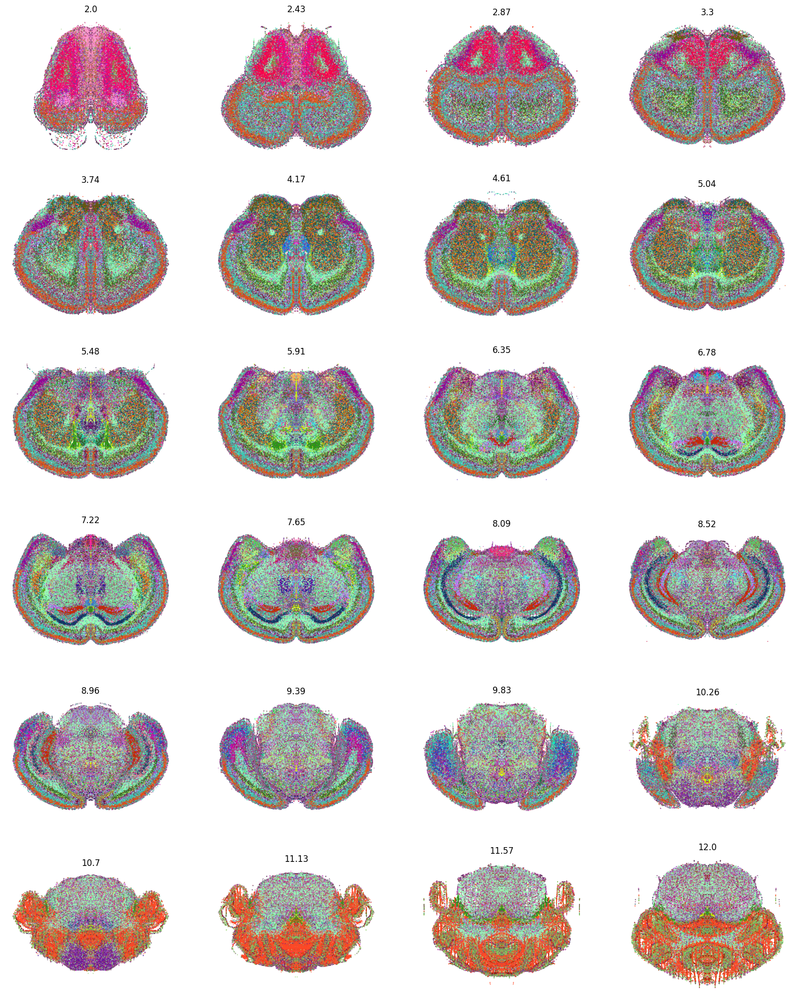

In [29]:
from tqdm import tqdm
n_rows = 6
n_columns = 4
n_figures = n_rows*n_columns
fig,axs = plt.subplots(n_rows,n_columns,figsize=[20,25])
window = 0.15
zs = np.linspace(2,12,n_figures)
axs = axs.ravel()
for i,z in tqdm(enumerate(zs),total=zs.shape[0]):
    m = (reference_data['ccf_x']>z-window)&(reference_data['ccf_x']<z+window)
    m = np.random.choice(np.array(reference_data[m].index),100000)
    x = reference_data.loc[m,'ccf_z']
    y = reference_data.loc[m,'ccf_y']
    c = reference_data.loc[m,'subclass_color']
    axs[i].scatter(x,y,s=0.1,c=c)
    axs[i].scatter(-x,y,s=0.1,c=c)
    axs[i].set_title(str(round(z,2)))
    axs[i].axis('off')
    axs[i].set_aspect('equal')
plt.show()

100%|██████████| 24/24 [00:10<00:00,  2.29it/s]


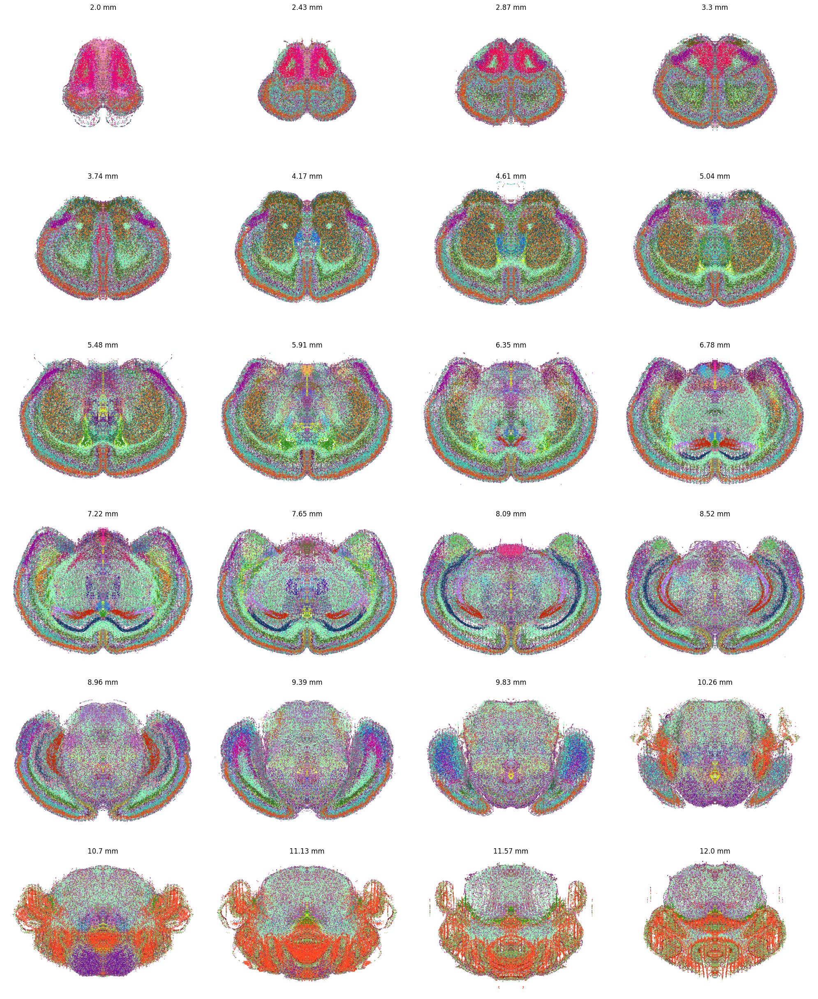

In [34]:
from tqdm import tqdm
n_rows = 6
n_columns = 4
n_figures = n_rows*n_columns
fig,axs = plt.subplots(n_rows,n_columns,figsize=[20,25])
window = 0.15
zs = np.linspace(2,12,n_figures)
axs = axs.ravel()
for i,z in tqdm(enumerate(zs),total=zs.shape[0]):
    m = (reference_data['ccf_x']>z-window)&(reference_data['ccf_x']<z+window)
    m = np.random.choice(np.array(reference_data[m].index),100000)
    x = reference_data.loc[m,'ccf_z']
    y = reference_data.loc[m,'ccf_y']
    c = reference_data.loc[m,'subclass_color']
    axs[i].scatter(x,y,s=0.1,c=c)
    axs[i].scatter(-x,y,s=0.1,c=c)
    axs[i].set_title(f"{str(round(z,2))} mm")
    axs[i].axis('off')
    axs[i].set_xlim([-reference_data['ccf_z'].max(),reference_data['ccf_z'].max()])
    axs[i].set_ylim([reference_data['ccf_y'].min(),reference_data['ccf_y'].max()])
    axs[i].set_aspect('equal')
plt.tight_layout()
plt.show()

100%|██████████| 24/24 [00:11<00:00,  2.17it/s]


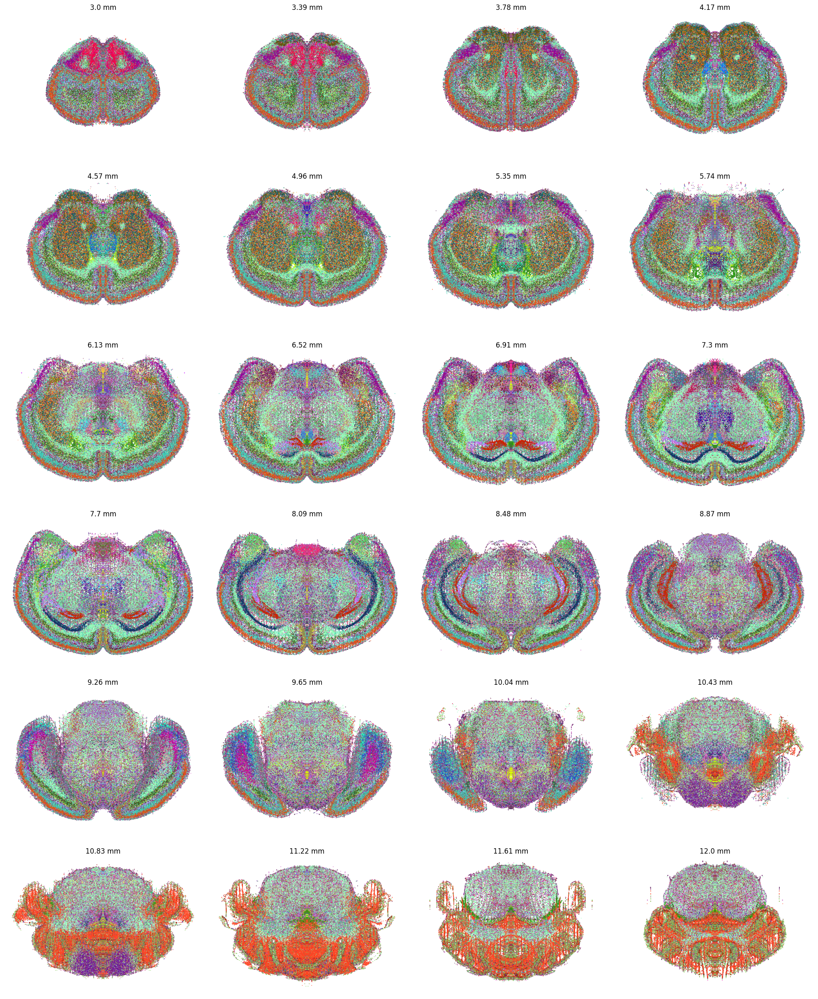

In [35]:
from tqdm import tqdm
n_rows = 6
n_columns = 4
n_figures = n_rows*n_columns
fig,axs = plt.subplots(n_rows,n_columns,figsize=[20,25])
window = 0.15
zs = np.linspace(3,12,n_figures)
axs = axs.ravel()
for i,z in tqdm(enumerate(zs),total=zs.shape[0]):
    m = (reference_data['ccf_x']>z-window)&(reference_data['ccf_x']<z+window)
    m = np.random.choice(np.array(reference_data[m].index),100000)
    x = reference_data.loc[m,'ccf_z']
    y = reference_data.loc[m,'ccf_y']
    c = reference_data.loc[m,'subclass_color']
    axs[i].scatter(x,y,s=0.1,c=c)
    axs[i].scatter(-x,y,s=0.1,c=c)
    axs[i].set_title(f"{str(round(z,2))} mm")
    axs[i].axis('off')
    axs[i].set_xlim([-reference_data['ccf_z'].max(),reference_data['ccf_z'].max()])
    axs[i].set_ylim([reference_data['ccf_y'].min(),reference_data['ccf_y'].max()])
    axs[i].set_aspect('equal')
plt.tight_layout()
plt.show()

100%|██████████| 24/24 [00:11<00:00,  2.14it/s]


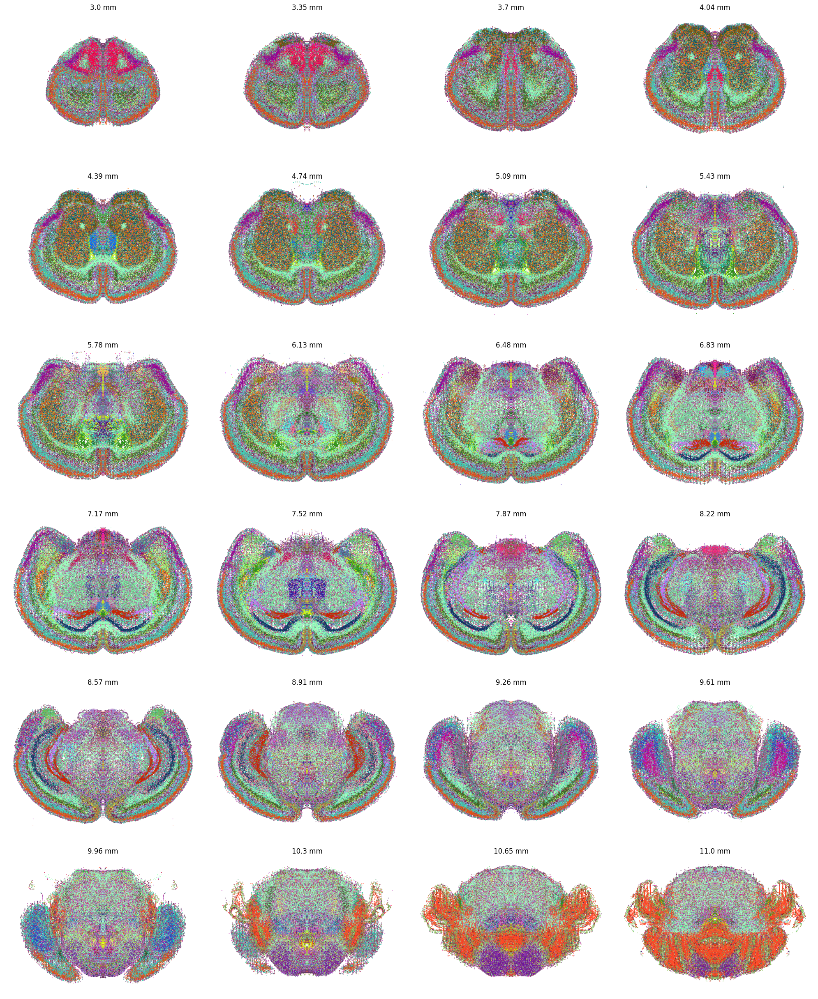

In [36]:
from tqdm import tqdm
n_rows = 6
n_columns = 4
n_figures = n_rows*n_columns
fig,axs = plt.subplots(n_rows,n_columns,figsize=[20,25])
window = 0.15
zs = np.linspace(3,11,n_figures)
axs = axs.ravel()
for i,z in tqdm(enumerate(zs),total=zs.shape[0]):
    m = (reference_data['ccf_x']>z-window)&(reference_data['ccf_x']<z+window)
    m = np.random.choice(np.array(reference_data[m].index),100000)
    x = reference_data.loc[m,'ccf_z']
    y = reference_data.loc[m,'ccf_y']
    c = reference_data.loc[m,'subclass_color']
    axs[i].scatter(x,y,s=0.1,c=c)
    axs[i].scatter(-x,y,s=0.1,c=c)
    axs[i].set_title(f"{str(round(z,2))} mm")
    axs[i].axis('off')
    axs[i].set_xlim([-reference_data['ccf_z'].max(),reference_data['ccf_z'].max()])
    axs[i].set_ylim([reference_data['ccf_y'].min(),reference_data['ccf_y'].max()])
    axs[i].set_aspect('equal')
plt.tight_layout()
plt.show()